In [46]:
import numpy as np
import argparse
import cv2 as cv2
import matplotlib.pyplot as plt
from PIL import Image

import os

In [158]:
image_size = (1920, 1080) # width, height
calibration_file = "calibration.npz"
test_image_file = ""


calibrationParams = np.load(calibration_file)
mtx = calibrationParams['mtx']
dist = calibrationParams['dist']

In [159]:
w = image_size[0]
h = image_size[1]

# beta = 
newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, dist, (w,h), 1, (w,h))

In [191]:
base_folder = "C:/Users/littl/OneDrive - University of Toronto/Winter 2025/CSC2530/Project/datasets/scans/camera sweep/bathroom_new_a/images"
# "C:\Users\littl\OneDrive - University of Toronto\Winter 2025\CSC2530\Project\datasets\scans\camera sweep\bathroom_comprehensive0_a"

laserOffFolder = os.path.join(base_folder, "laserOff")
laserOnFolder = os.path.join(base_folder, "laserOn")

laserOffImageBaseName = "capture_"
laserOnImageBaseName = "laser_"



numCaptures = len(os.listdir(laserOnFolder))



    # laserLocationPixelsRectified = np.zeros((numCaptures, 2))

SSIM: 0.8216197654988044


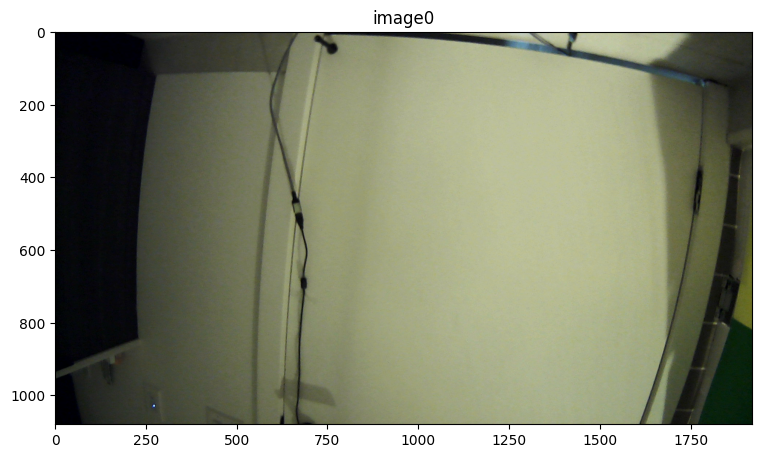

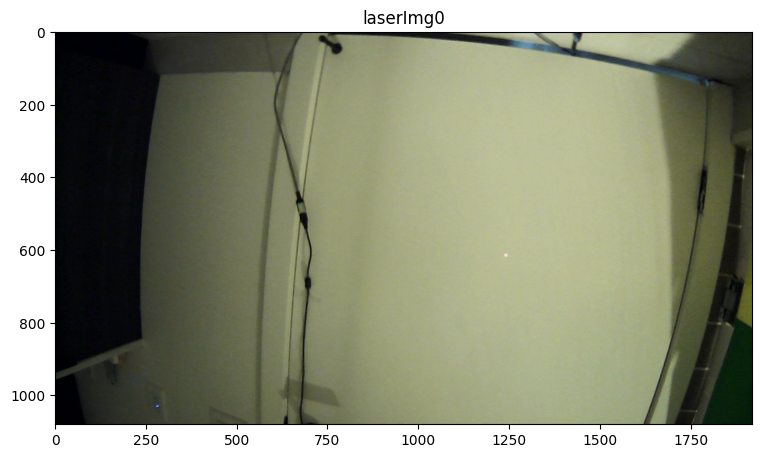

In [192]:
i = 0
laserOffImg = laserOffImageBaseName + str(i) +".png"
laserOffImgFile = os.path.join(laserOffFolder, laserOffImg)

laserOnImg = laserOnImageBaseName + str(i) +".png"
laserOnImgFile = os.path.join(laserOnFolder, laserOnImg)


img = cv2.imread(laserOffImgFile)
img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR )
plt.figure(figsize=(9, 6))
title = "image" +str(i)
plt.title(title)
plt.imshow(img)

laserImg = cv2.imread(laserOnImgFile)
laserImg = cv2.cvtColor(laserImg, cv2.COLOR_RGB2BGR )
plt.figure(figsize=(9, 6))
title = "laserImg" +str(i)
plt.title(title)
plt.imshow(laserImg)

imgGrey = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
laserImgGrey = cv2.cvtColor(laserImg, cv2.COLOR_BGR2GRAY)

from skimage.metrics import structural_similarity as compare_ssim

(score, diff) = compare_ssim(imgGrey, laserImgGrey, full=True)
diff = (diff * 255).astype("uint8")
print("SSIM: {}".format(score))

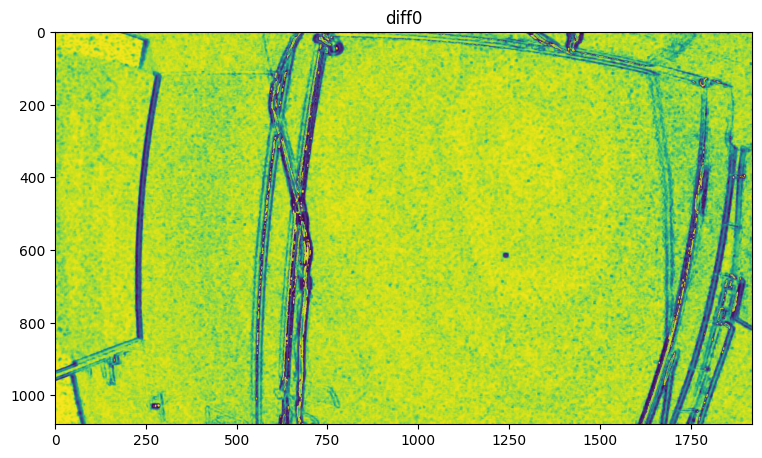

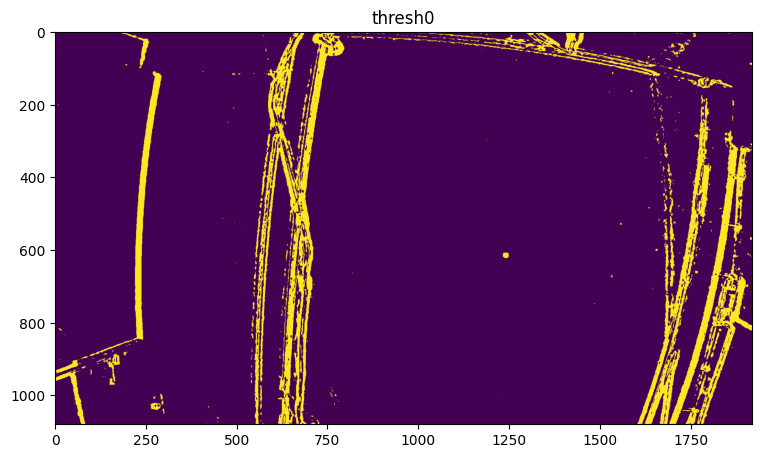

In [193]:
thresh = cv2.threshold(diff, 0, 255,
	cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)[1]
# cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL,
# 	cv2.CHAIN_APPROX_SIMPLE)
# cnts = imutils.grab_contours(cnts)

plt.figure(figsize=(9, 6))
title = "diff" +str(i)
plt.title(title)
plt.imshow(diff)

plt.figure(figsize=(9, 6))
title = "thresh" +str(i)
plt.title(title)
plt.imshow(thresh)

SSIM: 0.9413827280930217
(11, 0)


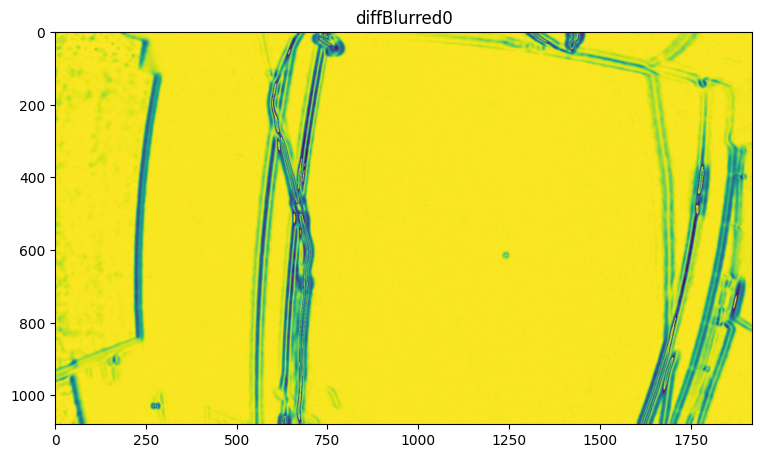

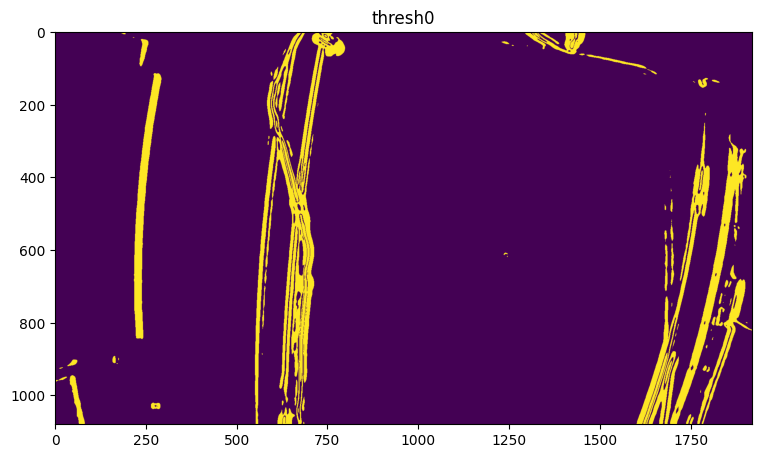

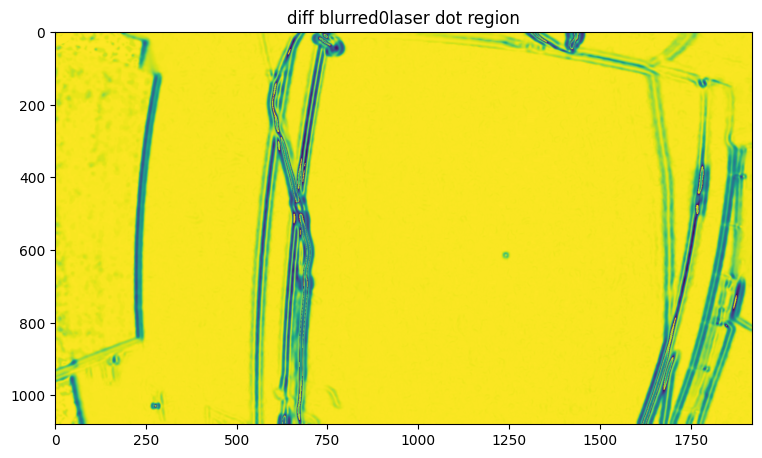

In [194]:
radius = 25
grayBlurred = cv2.GaussianBlur(imgGrey, (radius, radius), 0)
laserGrayBlurred = cv2.GaussianBlur(laserImgGrey, (radius, radius), 0)

(score, diffBlurred) = compare_ssim(grayBlurred, laserGrayBlurred, full=True)
diffBlurred = (diffBlurred * 255).astype("uint8")
print("SSIM: {}".format(score))
# (minVal, maxVal, minLoc, maxLoc) = cv2.minMaxLoc(laserGrayBlurred)

threshBlurred = cv2.threshold(diffBlurred, 0, 255,
	cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)[1]
# cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL,
# 	cv2.CHAIN_APPROX_SIMPLE)
# cnts = imutils.grab_contours(cnts)

plt.figure(figsize=(9, 6))
title = "diffBlurred" +str(i)
plt.title(title)
plt.imshow(diffBlurred)

plt.figure(figsize=(9, 6))
title = "thresh" +str(i)
plt.title(title)
plt.imshow(threshBlurred)

(minVal, maxVal, minLoc, maxLoc) = cv2.minMaxLoc(diffBlurred)
print(maxLoc)

# laserLocationPixelsRectified[i-1][0] = maxLoc[0]
# laserLocationPixelsRectified[i-1][1] = maxLoc[1]    

annotated = diffBlurred.copy()
cv2.circle(annotated, maxLoc, radius, (255, 0, 0), 20)
plt.figure(figsize=(9, 6))
title = "diff blurred" +str(i) + "laser dot region"
plt.title(title)
plt.imshow(annotated)

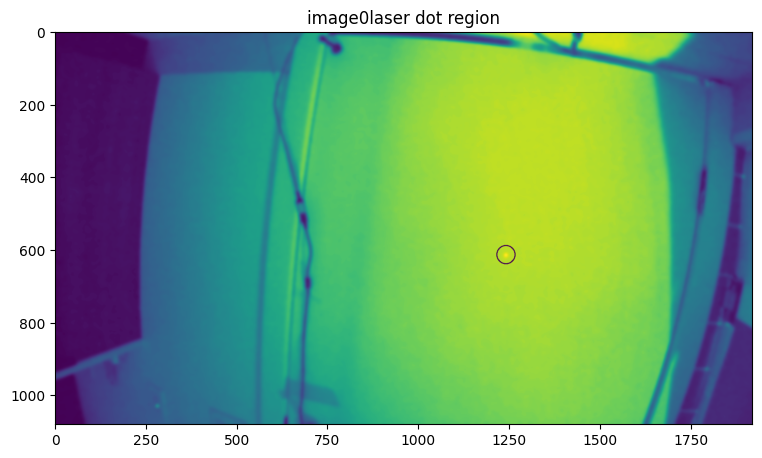

In [195]:
(minVal, maxVal, minLoc, maxLoc) = cv2.minMaxLoc(laserGrayBlurred)

# laserLocationPixelsRectified[i-1][0] = maxLoc[0]
# laserLocationPixelsRectified[i-1][1] = maxLoc[1]    

annotated = laserGrayBlurred.copy()
cv2.circle(annotated, maxLoc, radius, (0, 0, 255), 2)
plt.figure(figsize=(9, 6))
title = "image" +str(i) + "laser dot region"
plt.title(title)
plt.imshow(annotated)


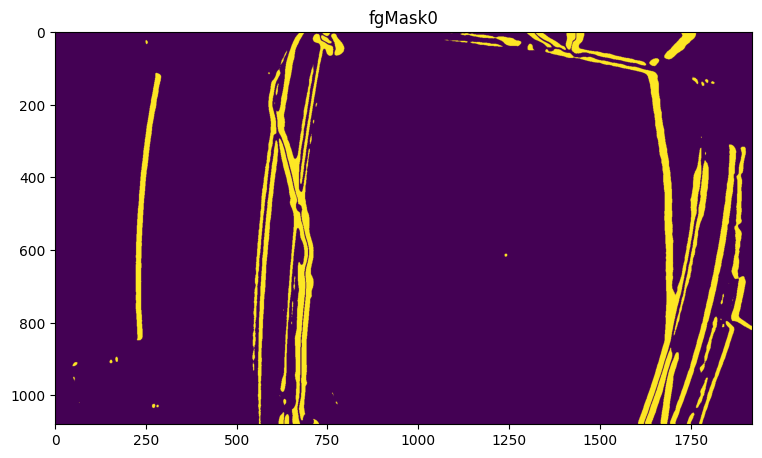

In [196]:
backSub = cv2.createBackgroundSubtractorMOG2()
backSub.apply(grayBlurred)

fgMask = backSub.apply(laserGrayBlurred)
plt.figure(figsize=(9, 6))
title = "fgMask" +str(i)
plt.title(title)
plt.imshow(fgMask)


In [197]:
# From https://learnopencv.com/video-stabilization-using-point-feature-matching-in-opencv/
# Pre-define transformation-store array
n_frames = 2
transforms = np.zeros((n_frames-1, 3), np.float32)
# laserGrayBlurred
prev_pts = cv2.goodFeaturesToTrack(imgGrey,
                                     maxCorners=200,
                                     qualityLevel=0.01,
                                     minDistance=30,
                                     blockSize=3)
# curr_pts, status, err = cv2.calcOpticalFlowPyrLK(grayBlurred, laserGrayBlurred, prev_pts, None) 
curr_pts, status, err = cv2.calcOpticalFlowPyrLK(imgGrey, laserImgGrey, prev_pts, None) 


idx = np.where(status==1)[0]
prev_pts = prev_pts[idx]
curr_pts = curr_pts[idx]

m, inliers = cv2.estimateAffine2D (prev_pts, curr_pts) #will only work with OpenCV-3 or less

# Extract traslation
dx = m[0,2]
dy = m[1,2]
# Extract rotation angle
da = np.arctan2(m[1,0], m[0,0])

print("Frame: " + str(i) + " -  Tracked points : " + str(len(prev_pts)))


Frame: 0 -  Tracked points : 124


[[ 1.00055852e+00 -1.86581244e-03  1.21081696e+01]
 [ 1.39937582e-04  9.99785675e-01 -3.09686341e-01]]
[[ 1.00055852e+00 -1.86581244e-03]
 [ 1.39937582e-04  9.99785675e-01]]
[[ 1.00055852e+00  1.39937582e-04 -1.21081696e+01]
 [-1.86581244e-03  9.99785675e-01  3.09686341e-01]]


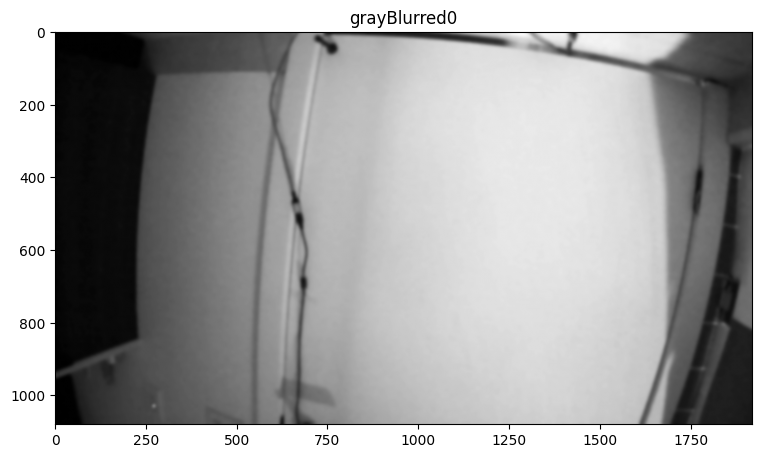

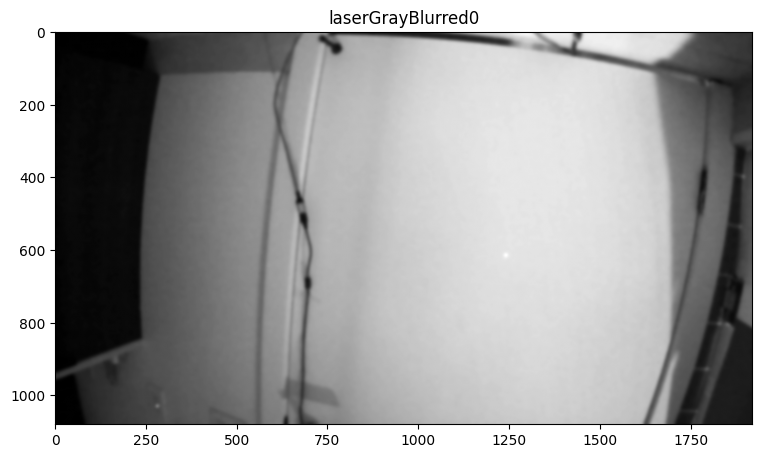

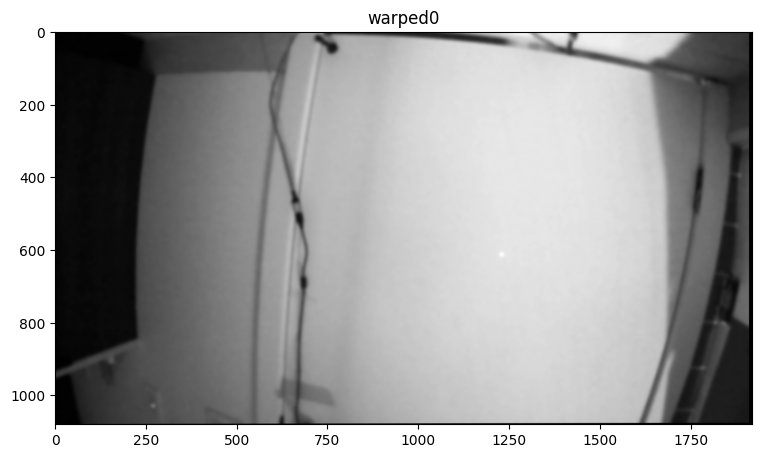

In [198]:
print(m)
R = m[:,0:2]
print(R)
Rinv = np.transpose(R)
t = m[:,2]
tinv = -t

Minv = np.zeros((2,3))
Minv[:,0:2] = Rinv

Minv[:,2] = -t

print(Minv)

warped = cv2.warpAffine(laserGrayBlurred, Minv, image_size)

plt.figure(figsize=(9, 6))
title = "grayBlurred" +str(i)
plt.title(title)
plt.imshow(grayBlurred, cmap='gray')

plt.figure(figsize=(9, 6))
title = "laserGrayBlurred" +str(i)
plt.title(title)
plt.imshow(laserGrayBlurred, cmap='gray')

plt.figure(figsize=(9, 6))
title = "warped" +str(i)
plt.title(title)
plt.imshow(warped, cmap='gray')


In [199]:
# Should apply cropping here

SSIM: 0.9850624737013494


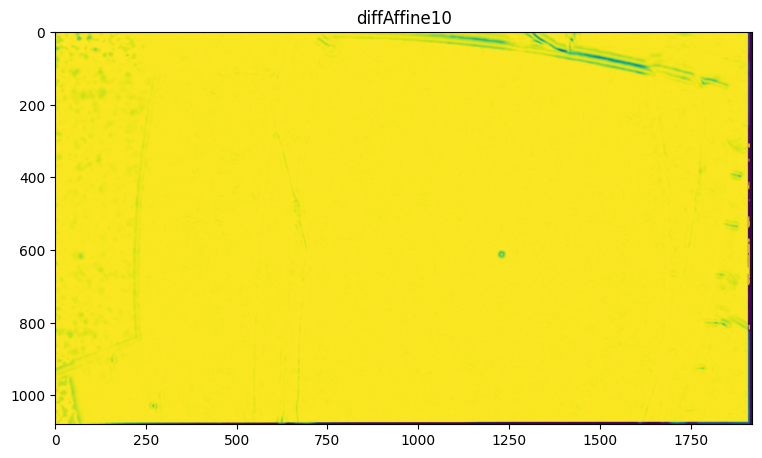

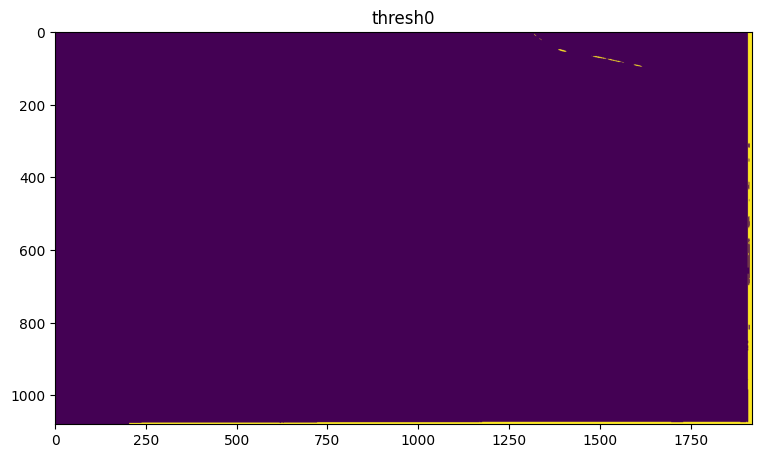

In [200]:
(score, diffBlurred) = compare_ssim(warped, grayBlurred, full=True)
diffBlurred = (diffBlurred * 255).astype("uint8")
print("SSIM: {}".format(score))
# (minVal, maxVal, minLoc, maxLoc) = cv2.minMaxLoc(laserGrayBlurred)

threshBlurred = cv2.threshold(diffBlurred, 0, 255,
	cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)[1]
# cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL,
# 	cv2.CHAIN_APPROX_SIMPLE)
# cnts = imutils.grab_contours(cnts)

plt.figure(figsize=(9, 6))
title = "diffAffine1" +str(i)
plt.title(title)
plt.imshow(diffBlurred)

plt.figure(figsize=(9, 6))
title = "thresh" +str(i)
plt.title(title)
plt.imshow(threshBlurred)


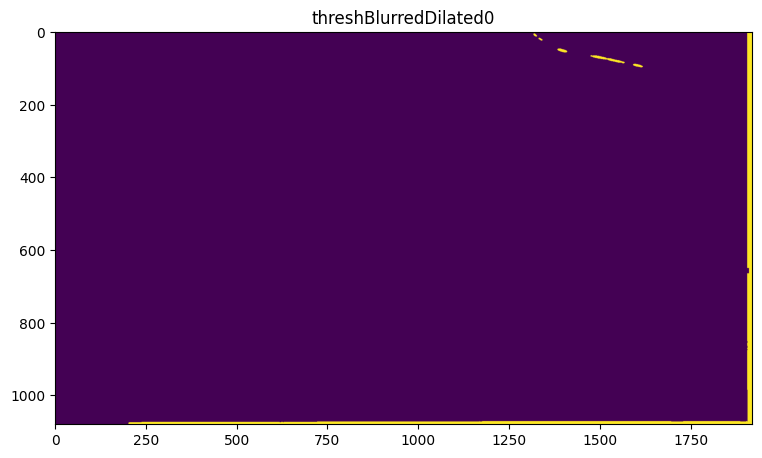

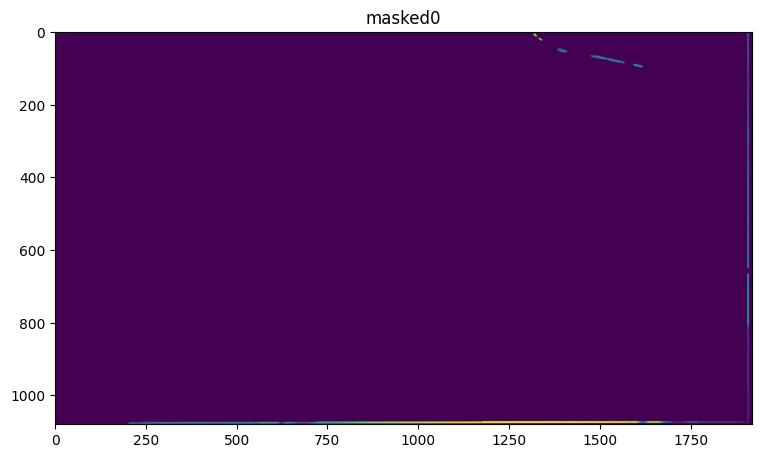

In [201]:

# dilation_size = 5
structuringElement = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5,5))
threshBlurredDilated = cv2.dilate(threshBlurred,structuringElement) 

# threshBlurredDilatedUnWarped = cv2.warpAffine(threshBlurredDilated, M, image_size)
# masked = cv2.bitwise_and(laserGrayBlurred, threshBlurredDilatedUnWarped)
masked = cv2.bitwise_and(warped, threshBlurredDilated)


plt.figure(figsize=(9, 6))
title = "threshBlurredDilated" +str(i)
plt.title(title)
plt.imshow(threshBlurredDilated)

plt.figure(figsize=(9, 6))
title = "masked" +str(i)
plt.title(title)
plt.imshow(masked)

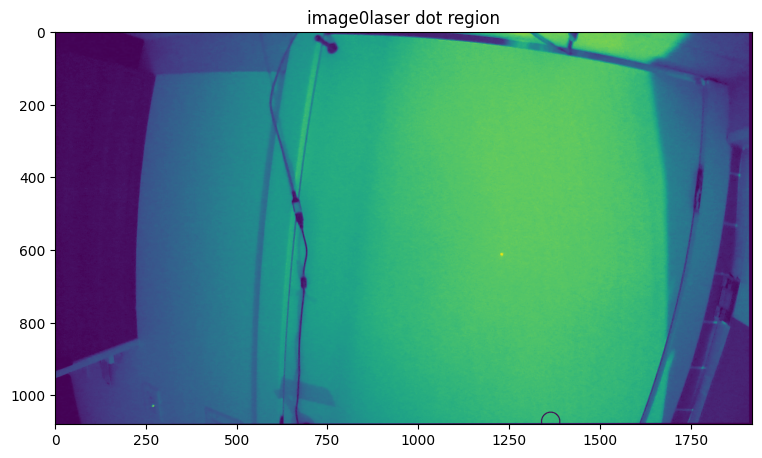

In [202]:
warped = cv2.warpAffine(laserImgGrey, Minv, image_size)
masked = cv2.bitwise_and(warped, threshBlurredDilated)

(minVal, maxVal, minLoc, maxLoc) = cv.minMaxLoc(masked)

annotated = warped.copy()
cv.circle(annotated, maxLoc, radius, (0, 0, 255), 2)
plt.figure(figsize=(9, 6))
title = "image" +str(i) + "laser dot region"
plt.title(title)
plt.imshow(annotated)

In [203]:
laserImg.shape

(1080, 1920, 3)

(282, 1032)


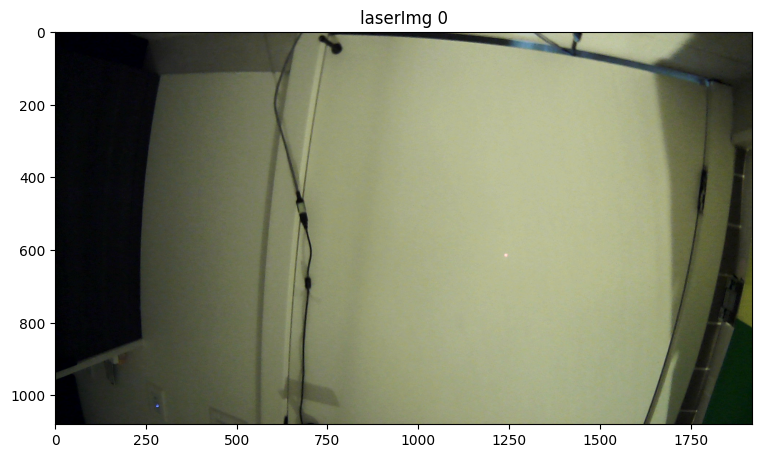

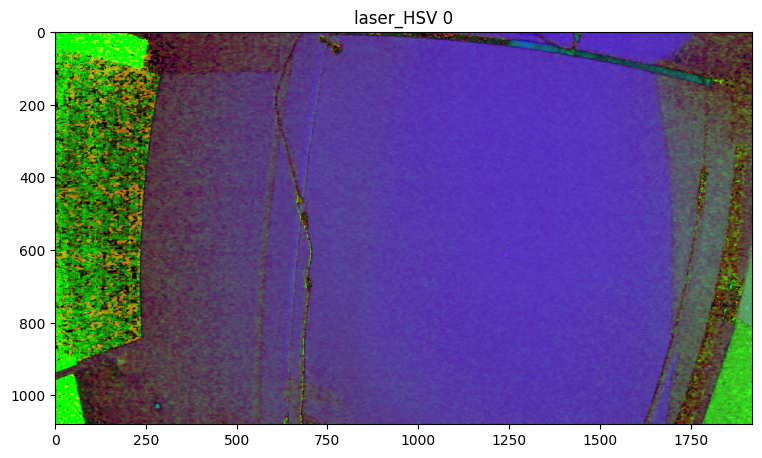

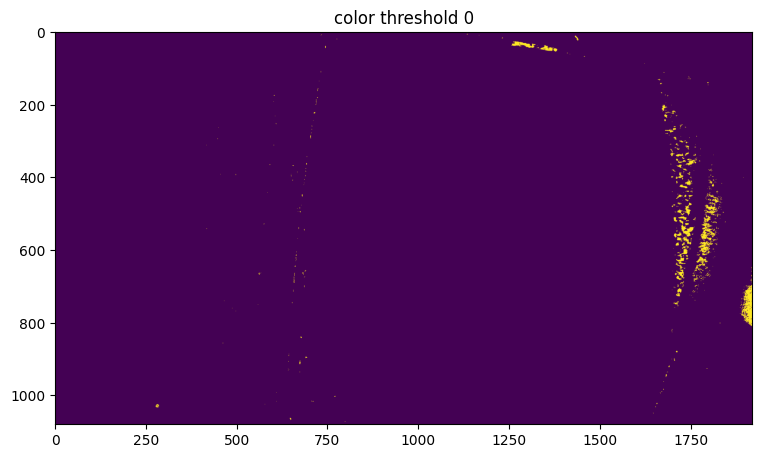

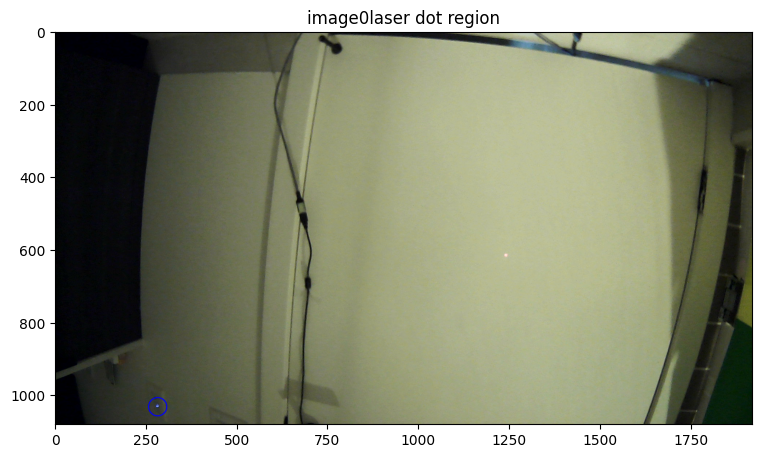

In [204]:
laser_HSV = cv.cvtColor(laserImg, cv2.COLOR_BGR2HSV)

lowerLimit = (0,100,100) # (10,255,255)
upperLimit = (179,255,255) # (160,100,100) # (179,255,255)

plt.figure(figsize=(9, 6))
title = "laserImg " +str(i)
plt.title(title)
plt.imshow(laserImg)

plt.figure(figsize=(9, 6))
title = "laser_HSV " +str(i)
plt.title(title)
plt.imshow(laser_HSV)

threshold = cv.inRange(laser_HSV, lowerLimit, upperLimit)

plt.figure(figsize=(9, 6))
title = "color threshold " +str(i)
plt.title(title)
plt.imshow(threshold)

RedMasked = cv2.bitwise_and(laserImgGrey, threshold)


(minVal, maxVal, minLoc, maxLoc) = cv.minMaxLoc(RedMasked)

print(maxLoc)

annotated = laserImg.copy()
cv.circle(annotated, maxLoc, radius, (0, 0, 255), 2)
plt.figure(figsize=(9, 6))
title = "image" +str(i) + "laser dot region"
plt.title(title)
plt.imshow(annotated)

In [205]:
# idea  - can use undistortPoints() 
# detect laser dot in distroted image
# apply undistort Points
# https://docs.opencv.org/3.4/da/d54/group__imgproc__transform.html#ga55c716492470bfe86b0ee9bf3a1f0f7e

"""
Ideas - do affine warp on rectified image

idea - only show red channel
idea - normalize blurred image?
"""

'\nIdeas - do affine warp on rectified image\n\nidea - only show red channel\nidea - normalize blurred image?\n'

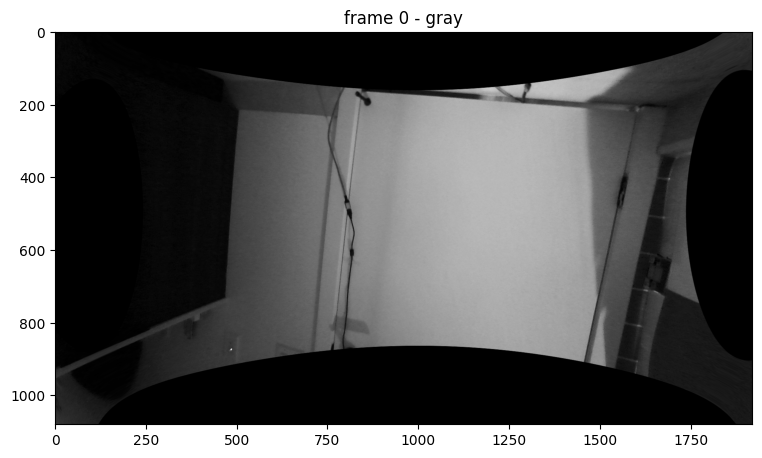

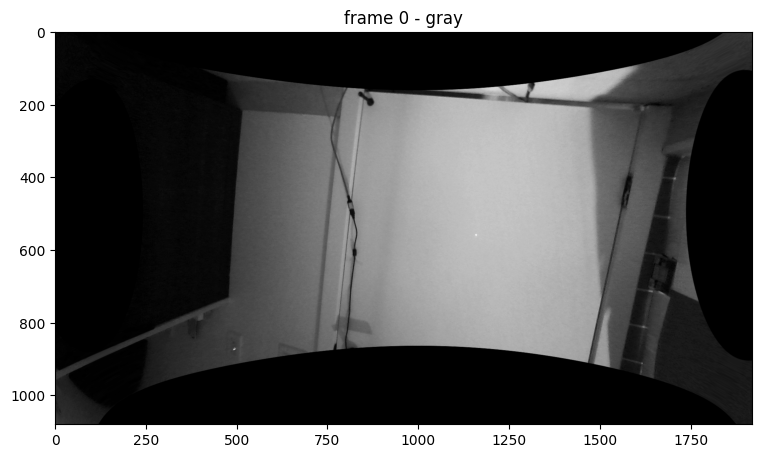

In [206]:
img_rectified = cv.undistort(img, mtx, dist, None, newcameramtx)
gray_rectified = cv.cvtColor(img_rectified, cv.COLOR_BGR2GRAY)
gray_rectified.shape
plt.figure(figsize=(9, 6))
plt.title(f"frame 0 - gray")
plt.imshow(gray_rectified, cmap='gray')

laser_rectified = cv.undistort(laserImg, mtx, dist, None, newcameramtx)
laser_gray_rectified = cv.cvtColor(laser_rectified, cv.COLOR_BGR2GRAY)

plt.figure(figsize=(9, 6))
plt.title(f"frame 0 - gray")
plt.imshow(laser_gray_rectified, cmap='gray')

Capture:  0
SSIM: 0.23706243050011327
1150 1350 500 700
(1080, 1920)
1
(1150, 500)
Capture:  12
SSIM: 0.20680585623879683
1050 1250 400 600
(1080, 1920)
1
(1050, 400)
Capture:  24
SSIM: 0.1666172211130383
950 1150 300 500
(1080, 1920)
1
(954, 300)
Capture:  36


C:\Users\littl\AppData\Local\Temp\ipykernel_29312\2142500225.py:107: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=figSize)


SSIM: 0.16904705662366531
854 1054 200 400
(1080, 1920)
1
(855, 200)
Capture:  48
SSIM: 0.20710344550284124
755 955 100 300
(1080, 1920)
1
(756, 100)
Capture:  60
SSIM: 0.25426621358811674
656 856 0 200
(1080, 1920)
1
(656, 0)


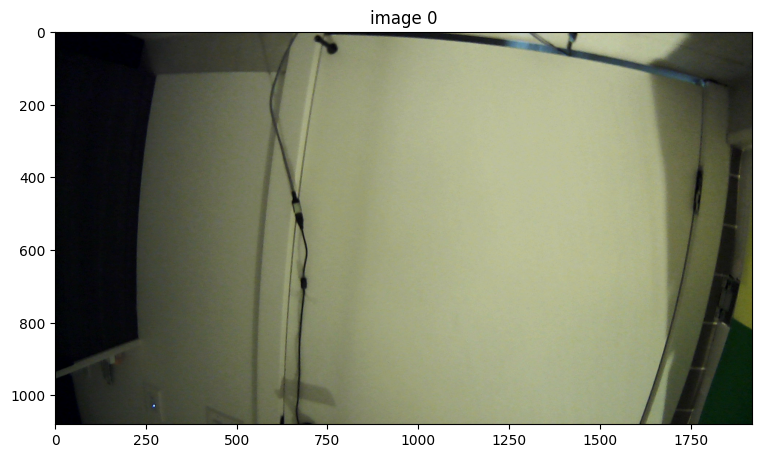

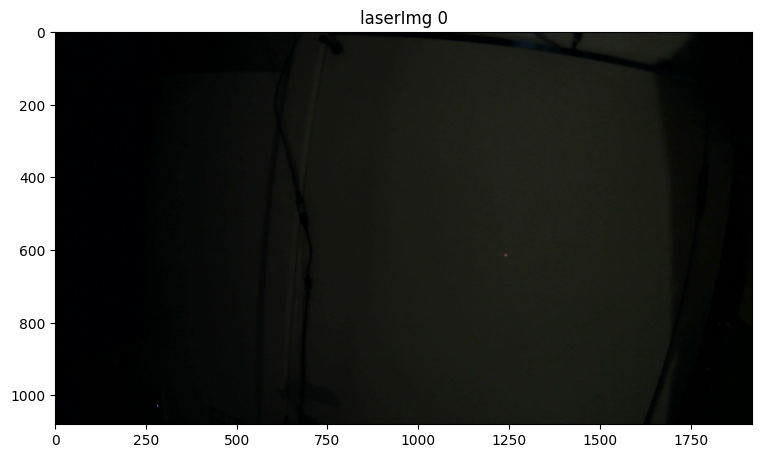

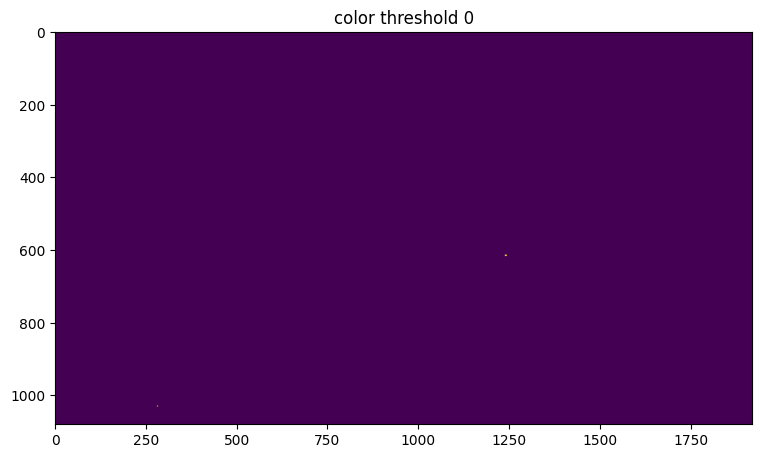

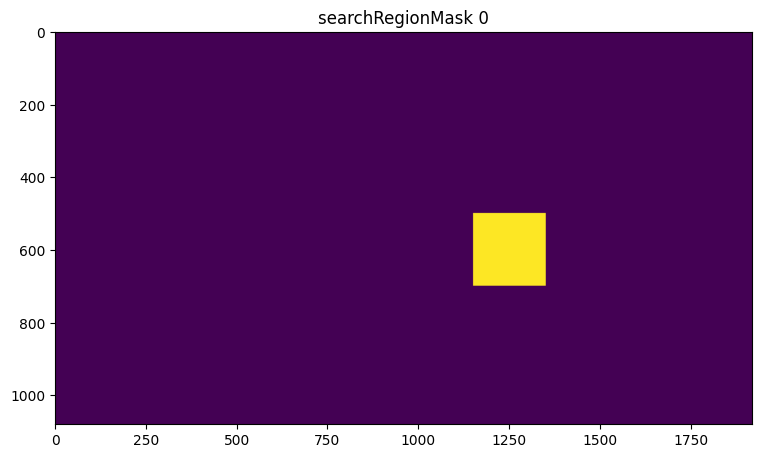

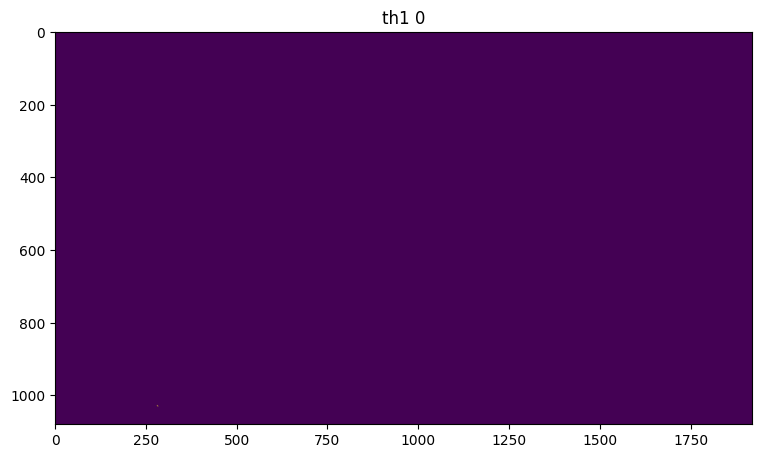

...

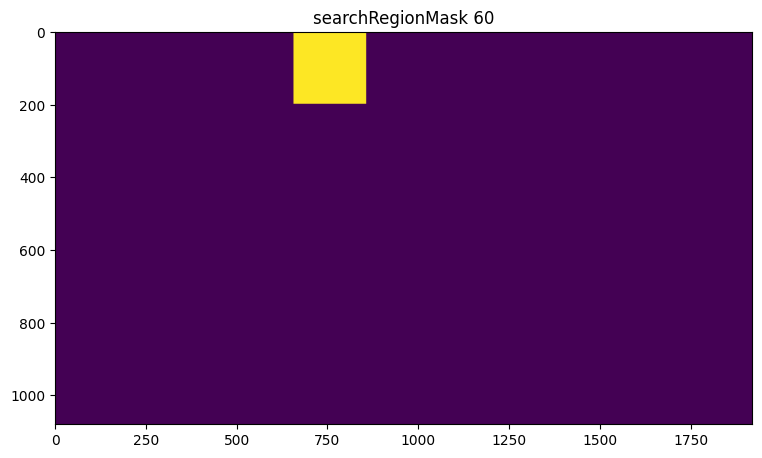

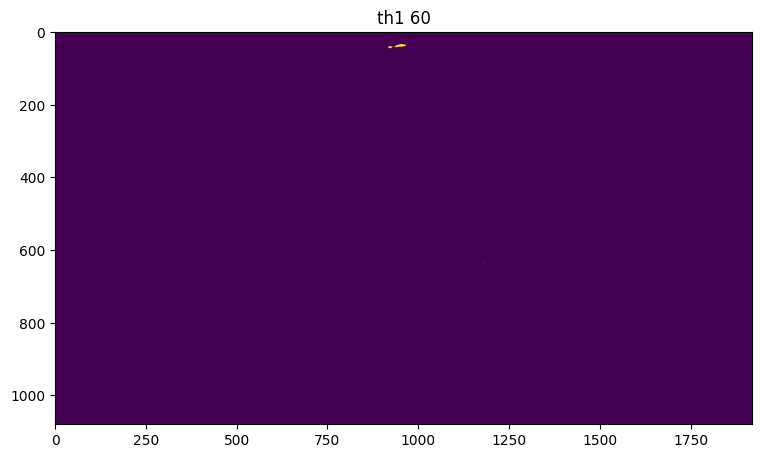

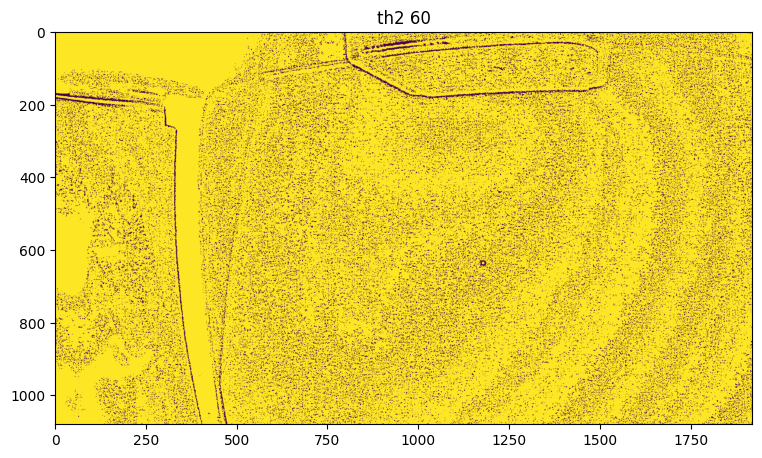

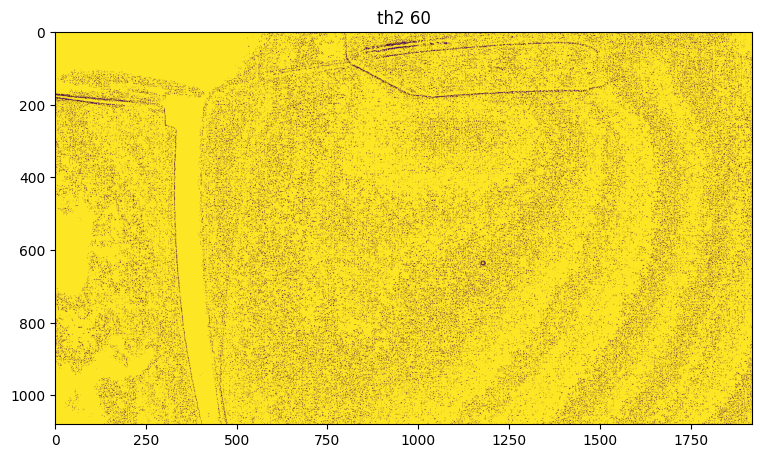

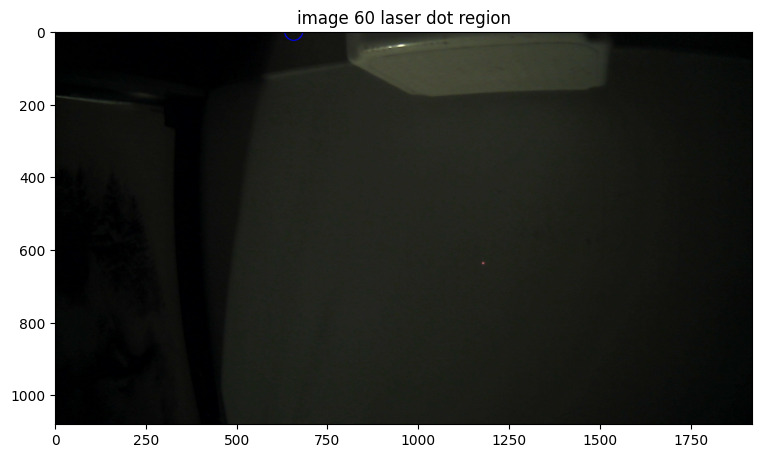

In [227]:
skipStep = 12

redLowerLimit = (0,100,100) # (10,255,255)
redUpperLimit = (179,255,255) # (160,100,100) # (179,255,255)

figSize = (9,6)

prevLaserLocation = (1250, 600)

searchBoxW = 200
searchBoxH = 200


for i in range(0,numCaptures, skipStep):
    print("Capture: ", str(i))

    laserOffImg = laserOffImageBaseName + str(i) +".png"
    laserOffImgFile = os.path.join(laserOffFolder, laserOffImg)

    laserOnImg = laserOnImageBaseName + str(i) +".png"
    laserOnImgFile = os.path.join(laserOnFolder, laserOnImg)
    
    
    img = cv2.imread(laserOffImgFile)
    img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR )
    plt.figure(figsize=figSize)
    title = "image " +str(i)
    plt.title(title)
    plt.imshow(img)

    laserImg = cv2.imread(laserOnImgFile)
    laserImg = cv2.cvtColor(laserImg, cv2.COLOR_RGB2BGR )
    plt.figure(figsize=figSize)
    title = "laserImg " +str(i)
    plt.title(title)
    plt.imshow(laserImg)

    imgGrey = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    laserImgGrey = cv2.cvtColor(laserImg, cv2.COLOR_BGR2GRAY)
    (score, diff) = compare_ssim(imgGrey, laserImgGrey, full=True)
    diff = (diff * 255).astype("uint8")
    print("SSIM: {}".format(score))

    laser_HSV = cv.cvtColor(laserImg, cv2.COLOR_BGR2HSV)    
    threshold = cv.inRange(laser_HSV, redLowerLimit, redUpperLimit)
        
    plt.figure(figsize=figSize)
    title = "color threshold " +str(i)
    plt.title(title)
    plt.imshow(threshold)
    


    prevLaserLocationX = prevLaserLocation[0]
    prevLaserLocationY = prevLaserLocation[1]

    searchBoxMinX = prevLaserLocationX - searchBoxW/2
    searchBoxMinY = prevLaserLocationY - searchBoxH/2
    searchBoxMaxX = prevLaserLocationX + searchBoxW/2
    searchBoxMaxY = prevLaserLocationY + searchBoxH/2

    # searchBoxMinX = int(np.clip(searchBoxMinX, 0, w))
    # searchBoxMinY = int(np.clip(searchBoxMinY, 0, h))
    # searchBoxMaxX = int(np.clip(searchBoxMaxX, 0, w))
    # searchBoxMaxY = int(np.clip(searchBoxMaxY, 0, h))

    searchBoxMinX = int(searchBoxMinX)
    searchBoxMinY = int(searchBoxMinY)
    searchBoxMaxX = int(searchBoxMaxX)
    searchBoxMaxY = int(searchBoxMaxY)
    

    print(searchBoxMinX, searchBoxMaxX, searchBoxMinY, searchBoxMaxY)

    searchRegionMask = np.zeros(laserImgGrey.shape, dtype="uint8")
    print(mask.shape)
    searchRegionMask[searchBoxMinY:searchBoxMaxY, searchBoxMinX:searchBoxMaxX] = 1

    print(np.max(searchRegionMask))
    
    plt.figure(figsize=figSize)
    title = "searchRegionMask " +str(i)
    plt.title(title)
    plt.imshow(searchRegionMask)
    
    searchRegionMasked = cv2.bitwise_and(laserImgGrey, searchRegionMask)
    # plt.figure(figsize=figSize)
    # title = "searchRegionMasked " +str(i)
    # plt.title(title)
    # plt.imshow(searchRegionMasked)

    # RedMasked = cv2.bitwise_and(laserImgGrey, threshold)
    # RedMaskedRestrictedSearchRegion = cv2.bitwise_and(RedMasked, searchRegionMask)
    (minVal, maxVal, minLoc, maxLoc) = cv.minMaxLoc(searchRegionMasked)

    # plt.figure(figsize=figSize)
    # title = "RedMaskedRestrictedSearchRegion " +str(i)
    # plt.title(title)
    # plt.imshow(RedMaskedRestrictedSearchRegion)

    ret,th1 = cv.threshold(laserImgGrey,127,255,cv.THRESH_BINARY)
    th2 = cv.adaptiveThreshold(laserImgGrey,255,cv.ADAPTIVE_THRESH_MEAN_C,\
                cv.THRESH_BINARY,11,2)
    th3 = cv.adaptiveThreshold(laserImgGrey,255,cv.ADAPTIVE_THRESH_GAUSSIAN_C,\
                cv.THRESH_BINARY,11,2)

    plt.figure(figsize=figSize)
    title = "th1 " +str(i)
    plt.title(title)
    plt.imshow(th1)

    plt.figure(figsize=figSize)
    title = "th2 " +str(i)
    plt.title(title)
    plt.imshow(th2)


    plt.figure(figsize=figSize)
    title = "th2 " +str(i)
    plt.title(title)
    plt.imshow(th3)
    
    print(maxLoc)
    prevLaserLocation = maxLoc
    
    annotated = laserImg.copy()
    cv.circle(annotated, maxLoc, radius, (0, 0, 255), 2)
    plt.figure(figsize=figSize)
    title = "image " +str(i) + " laser dot region"
    plt.title(title)
    plt.imshow(annotated)

In [132]:
print(laserOnFolder, laserOnImg)

C:/Users/littl/OneDrive - University of Toronto/Winter 2025/CSC2530/Project/datasets/scans/camera sweep/bathroom_comprehensive0_a/images\laserOn laser_0.png


In [133]:
print(laserOnImgFile)

C:/Users/littl/OneDrive - University of Toronto/Winter 2025/CSC2530/Project/datasets/scans/camera sweep/bathroom_comprehensive0_a/images\laserOn\laser_0.png


Capture:  0
SSIM: 0.239919368409141
1050 1450 500 700
(1080, 1920)
1
1
(1241, 612)
Capture:  12
SSIM: 0.20929083308309113
1041 1441 512 712
(1080, 1920)
1
1
(1227, 616)
Capture:  24
SSIM: 0.16792202393115888
1027 1427 516 716
(1080, 1920)
1
1
(1101, 640)
Capture:  36
SSIM: 0.17147868793348656
901 1301 540 740
(1080, 1920)
1
0
couldn't find red dot in search region. Searching brightest pixel in region instead


C:\Users\littl\AppData\Local\Temp\ipykernel_29312\775850677.py:65: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=figSize)


error: OpenCV(4.11.0) :-1: error: (-5:Bad argument) in function 'bitwise_and'
> Overload resolution failed:
>  - src2 is not a numerical tuple
>  - Expected Ptr<cv::UMat> for argument 'src2'


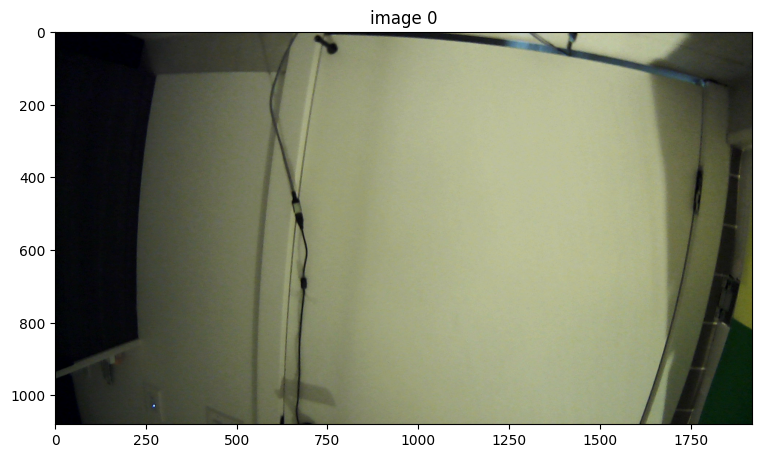

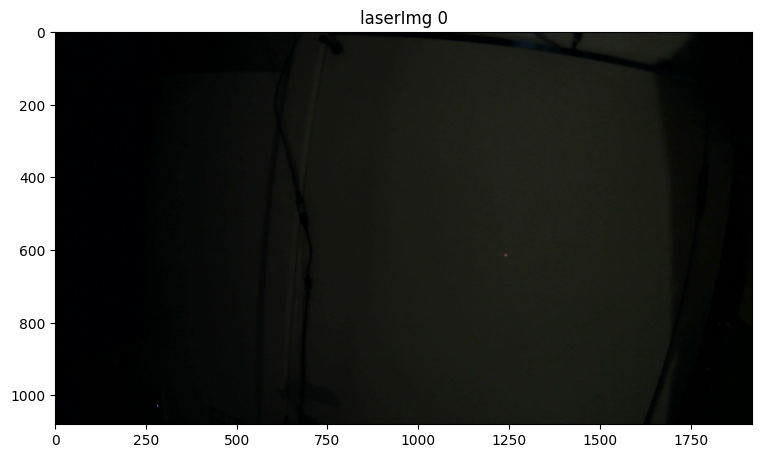

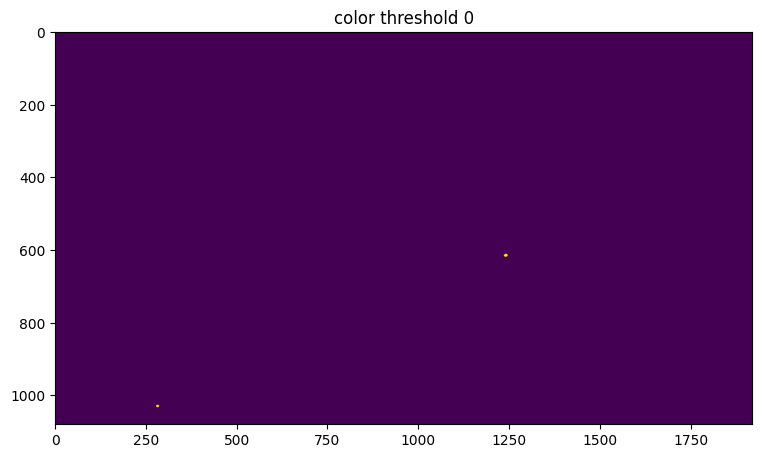

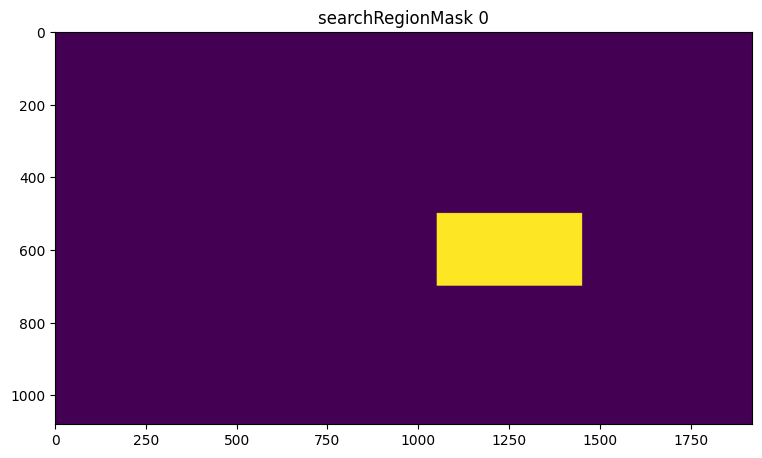

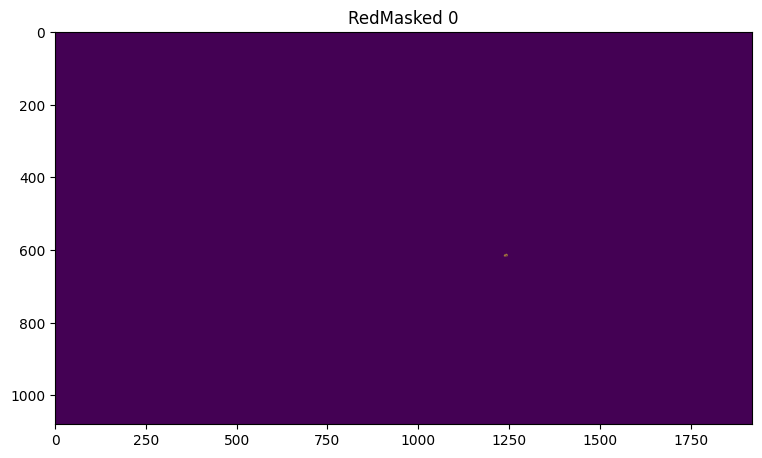

...

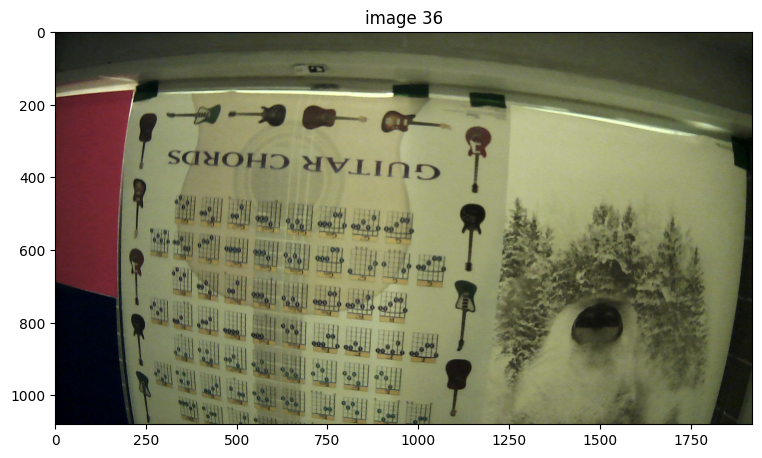

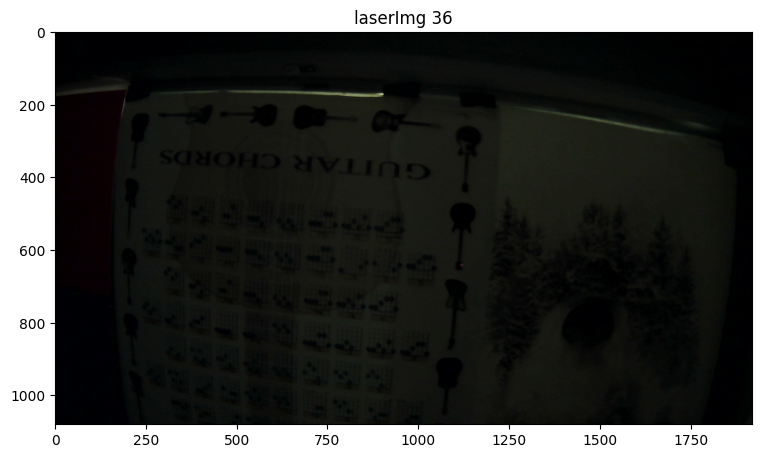

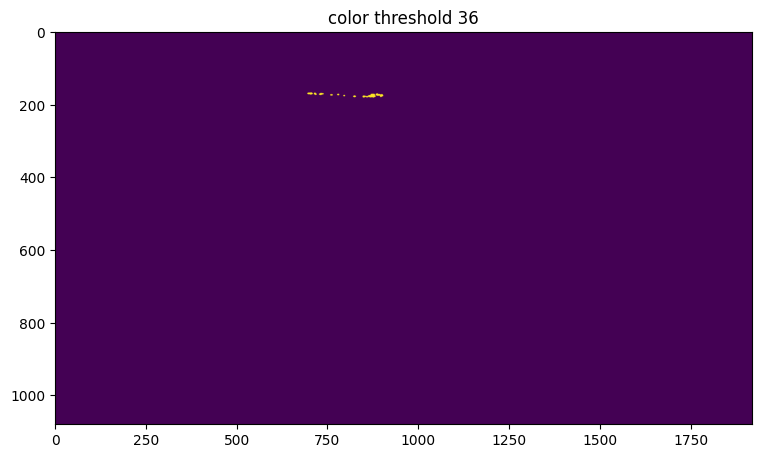

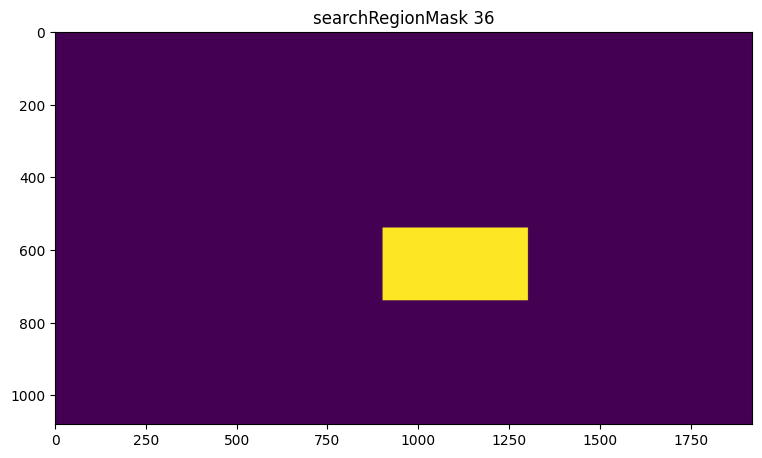

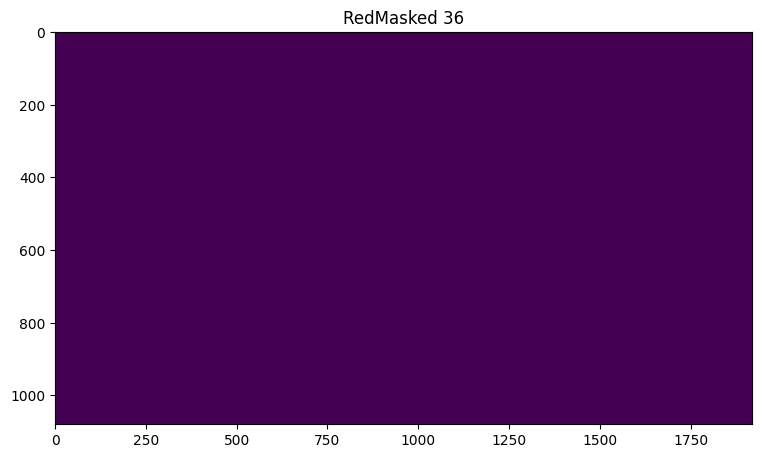

In [230]:
plt.close()
base_folder = "C:/Users/littl/OneDrive - University of Toronto/Winter 2025/CSC2530/Project/datasets/scans/camera sweep/bathroom_new_a/images"
# "C:\Users\littl\OneDrive - University of Toronto\Winter 2025\CSC2530\Project\datasets\scans\camera sweep\bathroom_comprehensive0_a"

laserOffFolder = os.path.join(base_folder, "laserOff")
laserOnFolder = os.path.join(base_folder, "laserLowExp")

laserOffImageBaseName = "capture_"
laserOnImageBaseName = "laser_low_exp_"

skipStep = 12

redLowerLimit = (0,100,100) # (0,100,100) (10,255,255)
redUpperLimit = (179,255,255) # (160,100,100) # (179,255,255)

figSize = (9,6)

prevLaserLocation = (1250, 600)

searchBoxW = 400
searchBoxH = 200

blur_radius = 5

for i in range(0,numCaptures, skipStep):
    print("Capture: ", str(i))

    laserOffImg = laserOffImageBaseName + str(i) +".png"
    laserOffImgFile = os.path.join(laserOffFolder, laserOffImg)

    laserOnImg = laserOnImageBaseName + str(i) +".png"
    laserOnImgFile = os.path.join(laserOnFolder, laserOnImg)
    
    
    img = cv2.imread(laserOffImgFile)
    img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR )
    plt.figure(figsize=figSize)
    title = "image " +str(i)
    plt.title(title)
    plt.imshow(img)

    laserImg = cv2.imread(laserOnImgFile)
    laserImg = cv2.cvtColor(laserImg, cv2.COLOR_RGB2BGR )
    plt.figure(figsize=figSize)
    title = "laserImg " +str(i)
    plt.title(title)
    plt.imshow(laserImg)

    imgGrey = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    laserImgGrey = cv2.cvtColor(laserImg, cv2.COLOR_BGR2GRAY)

    laserImgGrey = cv2.GaussianBlur(laserImgGrey, (blur_radius, blur_radius), 0)

    
    (score, diff) = compare_ssim(imgGrey, laserImgGrey, full=True)
    diff = (diff * 255).astype("uint8")
    print("SSIM: {}".format(score))

    laser_HSV = cv.cvtColor(laserImg, cv2.COLOR_BGR2HSV)    
    threshold = cv.inRange(laser_HSV, redLowerLimit, redUpperLimit)

    structuringElement = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5,5))
    threshold = cv2.dilate(threshold,structuringElement)  
        
    plt.figure(figsize=figSize)
    title = "color threshold " +str(i)
    plt.title(title)
    plt.imshow(threshold)
    


    prevLaserLocationX = prevLaserLocation[0]
    prevLaserLocationY = prevLaserLocation[1]

    searchBoxMinX = prevLaserLocationX - searchBoxW/2
    searchBoxMinY = prevLaserLocationY - searchBoxH/2
    searchBoxMaxX = prevLaserLocationX + searchBoxW/2
    searchBoxMaxY = prevLaserLocationY + searchBoxH/2

    searchBoxMinX = int(np.clip(searchBoxMinX, 0, w))
    searchBoxMinY = int(np.clip(searchBoxMinY, 0, h))
    searchBoxMaxX = int(np.clip(searchBoxMaxX, 0, w))
    searchBoxMaxY = int(np.clip(searchBoxMaxY, 0, h))

    # searchBoxMinX = int(searchBoxMinX)
    # searchBoxMinY = int(searchBoxMinY)
    # searchBoxMaxX = int(searchBoxMaxX)
    # searchBoxMaxY = int(searchBoxMaxY)
    

    print(searchBoxMinX, searchBoxMaxX, searchBoxMinY, searchBoxMaxY)

    searchRegionMask = np.zeros(laserImgGrey.shape, dtype="uint8")
    print(mask.shape)
    searchRegionMask[searchBoxMinY:searchBoxMaxY, searchBoxMinX:searchBoxMaxX] = 1

    print(np.max(searchRegionMask))
    
    plt.figure(figsize=figSize)
    title = "searchRegionMask " +str(i)
    plt.title(title)
    plt.imshow(searchRegionMask)
    
    searchRegionMasked = cv2.bitwise_and(laserImgGrey, searchRegionMask)
    # plt.figure(figsize=figSize)
    # title = "searchRegionMasked " +str(i)
    # plt.title(title)
    # plt.imshow(searchRegionMasked)

    RedMasked = cv2.bitwise_and(laserImgGrey, threshold)
    RedMasked = cv2.bitwise_and(RedMasked, searchRegionMask)

    
    plt.figure(figsize=figSize)
    title = "RedMasked " +str(i)
    plt.title(title)
    plt.imshow(RedMasked)
    (minVal, maxVal, minLoc, maxLoc) = cv.minMaxLoc(RedMasked)
    
    max_redMasked = np.max(RedMasked)
    print(max_redMasked)
    # RedMaskedRestrictedSearchRegion = cv2.bitwise_and(RedMasked, searchRegionMask)
    
    if(max_redMasked == 0):
        print("couldn't find red dot in search region. Searching brightest pixel in region instead" )
        # searchRegionThresholded = threshBlurred = cv2.threshold(diffBlurred, 0, 255, cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)[1]

        # searchRegionThreshold = cv.adaptiveThreshold(searchRegionMasked,255,cv.ADAPTIVE_THRESH_MEAN_C,cv.THRESH_BINARY,11,2)
        searchRegionThreshold = cv2.threshold(searchRegionMasked,50,255,cv.THRESH_BINARY)
        # searchRegionThreshold = cv2.dilate(searchRegionThreshold*255,structuringElement)  

        searchRegionThresholded = cv2.bitwise_and(searchRegionMasked, searchRegionThreshold)
        (minVal, maxVal, minLoc, maxLoc) = cv.minMaxLoc(searchRegionThresholded)

        plt.figure(figsize=figSize)
        title = "searchRegionThresholded " +str(i)
        plt.title(title)
        plt.imshow(searchRegionThresholded)


    
    print(maxLoc)
    prevLaserLocation = maxLoc
    
    annotated = laserImg.copy()
    cv.circle(annotated, maxLoc, radius, (0, 0, 255), 2)
    plt.figure(figsize=figSize)
    title = "image " +str(i) + " laser dot region"
    plt.title(title)
    plt.imshow(annotated)

In [ ]:
"""
Idea - threshold no laser image
Then threshold laser on image

Rotate laser image
Then compute difference, and apply mask
"""

Capture:  0
SSIM: 0.8216197654988044
1050 1350 600 700
(1080, 1920)
1
(1238, 614)
Capture:  12
SSIM: 0.8684914464151753
1050 1350 600 700
(1080, 1920)
1
(1232, 620)
Capture:  24
SSIM: 0.869265391169917
1050 1350 600 700
(1080, 1920)
1
(1101, 644)
Capture:  36
SSIM: 0.6107799739544397
1050 1350 600 700
(1080, 1920)
1
(1118, 642)
Capture:  48
SSIM: 0.8764685483671081
1050 1350 600 700
(1080, 1920)
1
(1237, 622)
Capture:  60
SSIM: 0.887847773999285
1050 1350 600 700
(1080, 1920)
1
(1177, 637)


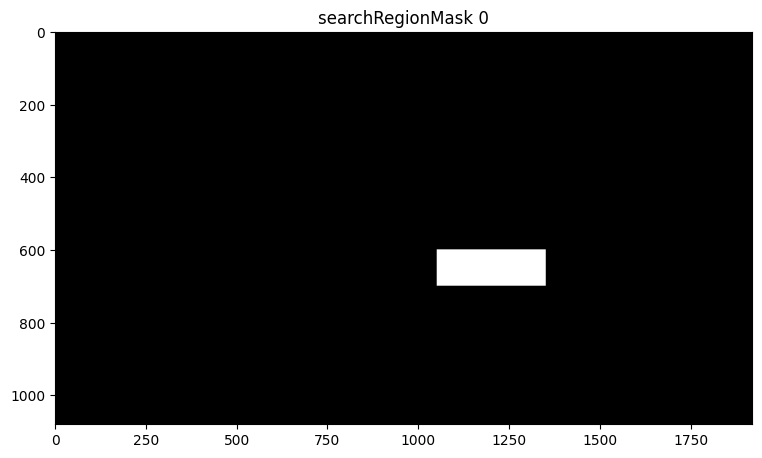

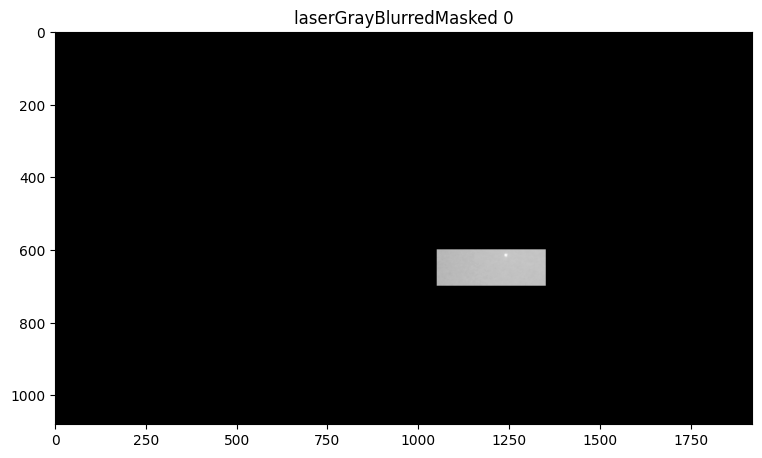

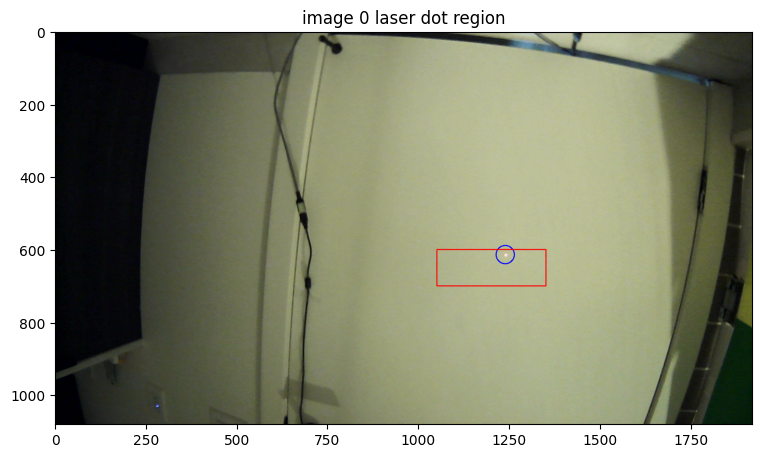

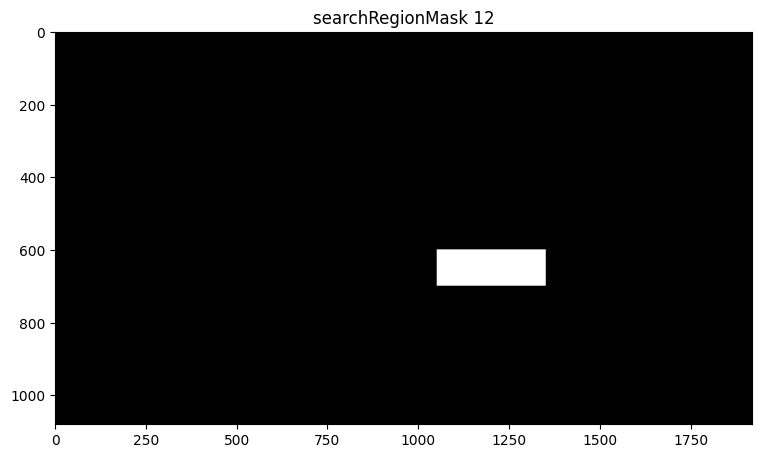

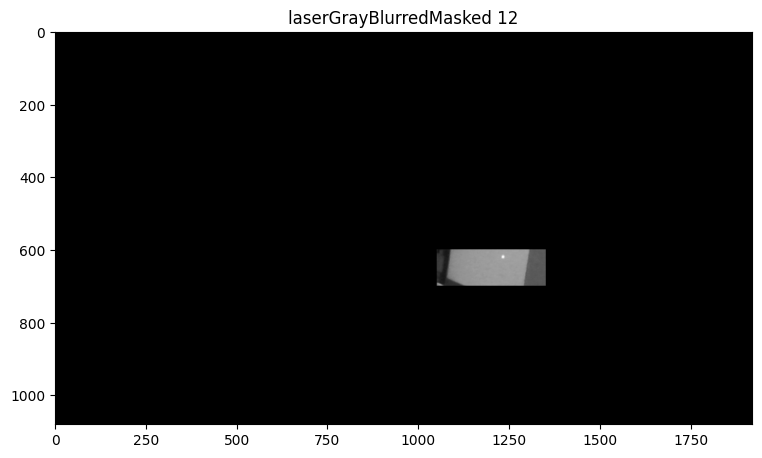

...

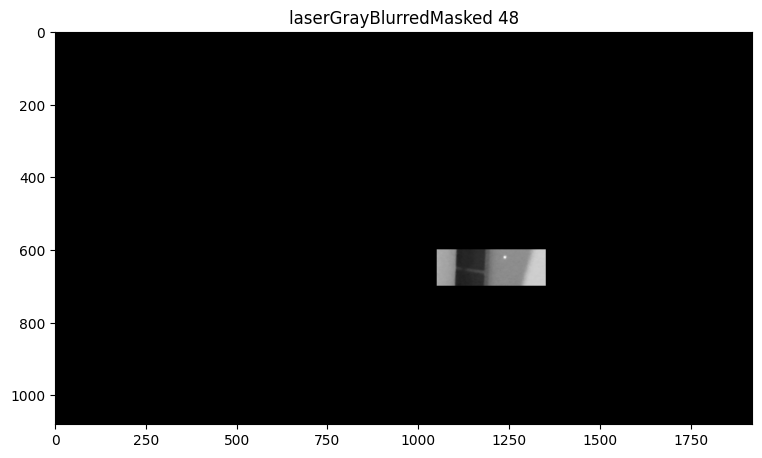

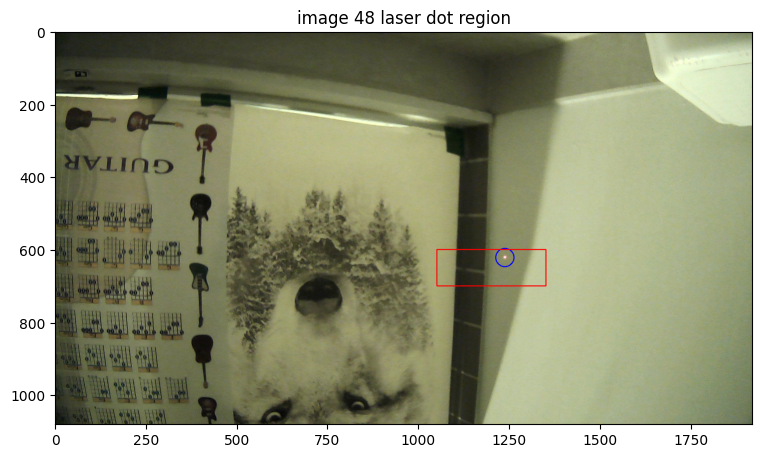

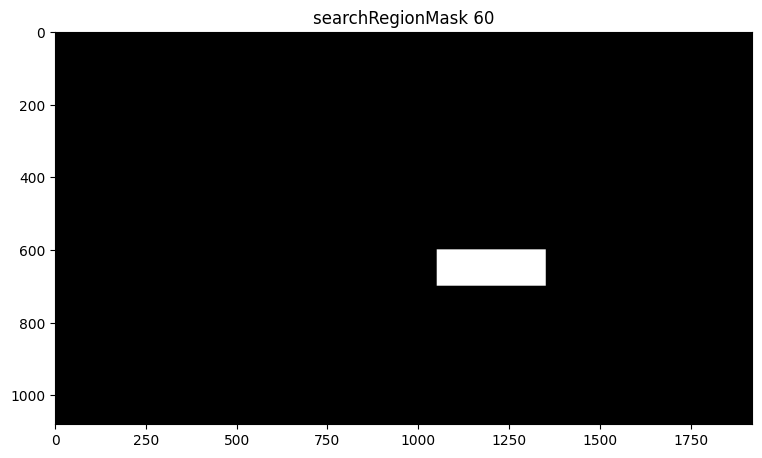

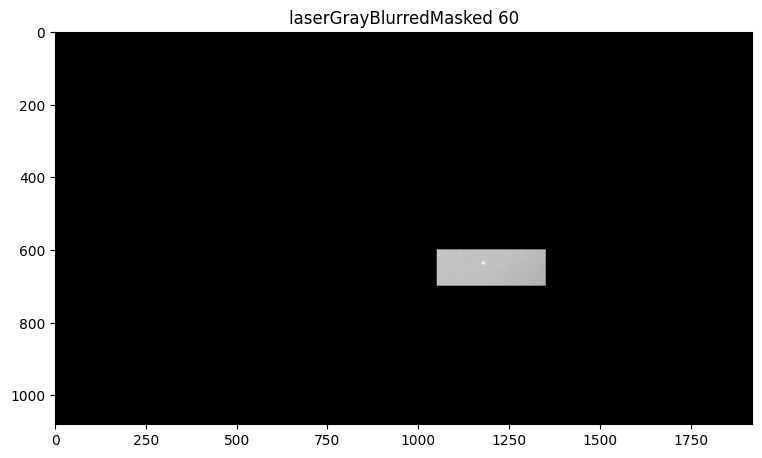

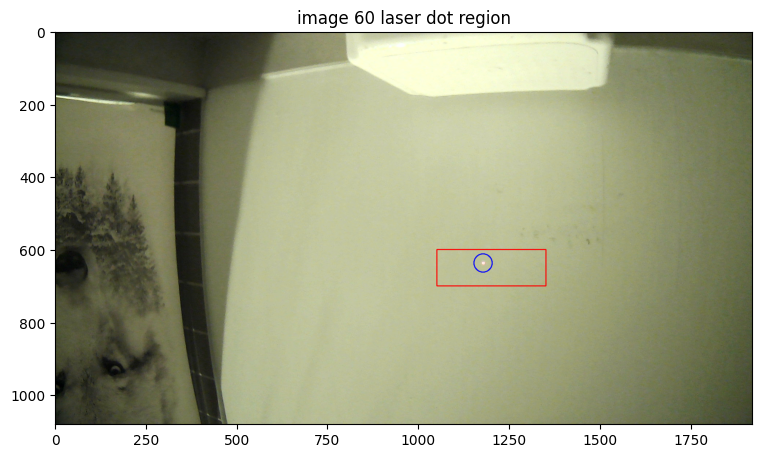

In [247]:
plt.close()

skipStep = 12

redLowerLimit = (0,100,100) # (10,255,255)
redUpperLimit = (179,255,255) # (160,100,100) # (179,255,255)

figSize = (9,6)

prevLaserLocation = (1250, 600)

searchBoxW = 200
searchBoxH = 200

laserOffFolder = os.path.join(base_folder, "laserOff")
laserOnFolder = os.path.join(base_folder, "laserOn")

laserOffImageBaseName = "capture_"
laserOnImageBaseName = "laser_"

for i in range(0,numCaptures, skipStep):
    print("Capture: ", str(i))

    laserOffImg = laserOffImageBaseName + str(i) +".png"
    laserOffImgFile = os.path.join(laserOffFolder, laserOffImg)

    laserOnImg = laserOnImageBaseName + str(i) +".png"
    laserOnImgFile = os.path.join(laserOnFolder, laserOnImg)
    
    
    img = cv2.imread(laserOffImgFile)
    img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR )
    # plt.figure(figsize=figSize)
    # title = "image " +str(i)
    # plt.title(title)
    # plt.imshow(img)

    laserImg = cv2.imread(laserOnImgFile)
    laserImg = cv2.cvtColor(laserImg, cv2.COLOR_RGB2BGR )
    # plt.figure(figsize=figSize)
    # title = "laserImg " +str(i)
    # plt.title(title)
    # plt.imshow(laserImg)

    imgGrey = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    laserImgGrey = cv2.cvtColor(laserImg, cv2.COLOR_BGR2GRAY)
    (score, diff) = compare_ssim(imgGrey, laserImgGrey, full=True)
    diff = (diff * 255).astype("uint8")
    print("SSIM: {}".format(score))

    searchBoxMinX = 1050
    searchBoxMinY = 600
    searchBoxMaxX = 1350
    searchBoxMaxY = 700

    searchBoxMinX = int(searchBoxMinX)
    searchBoxMinY = int(searchBoxMinY)
    searchBoxMaxX = int(searchBoxMaxX)
    searchBoxMaxY = int(searchBoxMaxY)
    

    print(searchBoxMinX, searchBoxMaxX, searchBoxMinY, searchBoxMaxY)

    searchRegionMask = np.zeros(laserImgGrey.shape, dtype="uint8")
    print(mask.shape)
    searchRegionMask[searchBoxMinY:searchBoxMaxY, searchBoxMinX:searchBoxMaxX] = 1

    print(np.max(searchRegionMask))
    
    plt.figure(figsize=figSize)
    title = "searchRegionMask " +str(i)
    plt.title(title)
    plt.imshow(searchRegionMask, cmap="gray")

    laserGrayBlurred = cv2.GaussianBlur(laserImgGrey, (blur_radius, blur_radius), 0)

    # searchRegionMasked = cv2.bitwise_and(laserGrayBlurred, searchRegionMask)
    # print(laserGrayBlurred.shape)
    searchRegionMasked = np.zeros(laserGrayBlurred.shape)
    searchRegionMasked[searchBoxMinY:searchBoxMaxY, searchBoxMinX:searchBoxMaxX] = laserGrayBlurred[searchBoxMinY:searchBoxMaxY, searchBoxMinX:searchBoxMaxX]

    # th3 = cv.adaptiveThreshold(searchRegionMasked,255,cv.ADAPTIVE_THRESH_GAUSSIAN_C,cv.THRESH_BINARY,11,2)

    (minVal, maxVal, minLoc, maxLoc) = cv.minMaxLoc(searchRegionMasked)

    plt.figure(figsize=figSize)
    title = "laserGrayBlurredMasked " +str(i)
    plt.title(title)
    plt.imshow(searchRegionMasked, cmap="gray")
    
    print(maxLoc)
    prevLaserLocation = maxLoc
    
    annotated = laserImg.copy()
    cv2.circle(annotated, maxLoc, radius, (0, 0, 255), 2)
    cv2.rectangle(annotated, (searchBoxMinX, searchBoxMinY), (searchBoxMaxX, searchBoxMaxY),(255, 0, 0),2 )
    plt.figure(figsize=figSize)
    title = "image " +str(i) + " laser dot region"
    plt.title(title)
    plt.imshow(annotated)